In [1]:
# This R environment comes with many helpful analytics packages installed
# It is defined by the kaggle/rstats Docker image: https://github.com/kaggle/docker-rstats
# For example, here's a helpful package to load

library(tidyverse) # metapackage of all tidyverse packages

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

list.files(path = "../input")

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


character(0)

In [3]:
R.version

               _                           
platform       x86_64-pc-linux-gnu         
arch           x86_64                      
os             linux-gnu                   
system         x86_64, linux-gnu           
status                                     
major          4                           
minor          4.0                         
year           2024                        
month          04                          
day            24                          
svn rev        86474                       
language       R                           
version.string R version 4.4.0 (2024-04-24)
nickname       Puppy Cup                   

In [4]:
#Pronósticos Sem2
##Aplicar un modelo lineal a la serie con tslm
install.packages("ddpcr")
#devtools::install_github("daattali/ddpcr")
install.packages("TSstudio")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [6]:
library(ddpcr)

In [7]:
library(forecast)
library(quantmod)
library(fpp3)
#library(fpp2)
library(stats)
library(tidymodels)
library(modeltime)
library(tidyverse)
library(lubridate)
library(timetk)
library(tsfeatures)
library(TSstudio)
library(dplyr)
library(fable)
library(fabletools)
library(feasts)
library(ggplot2)
library(tibble)
library(tidyr)
library(tidyverse)
library(tsibble)
library(tsibbledata)

library(TSstudio)
library(MAPA)

interactive <- TRUE
options(warn = - 1)

Registered S3 method overwritten by 'quantmod':
  method            from
  as.zoo.data.frame zoo 

Loading required package: xts

Loading required package: zoo


Attaching package: ‘zoo’


The following objects are masked from ‘package:base’:

    as.Date, as.Date.numeric



######################### Warning from 'xts' package ##########################
#                                                                             #
# The dplyr lag() function breaks how base R's lag() function is supposed to  #
# work, which breaks lag(my_xts). Calls to lag(my_xts) that you type or       #
# source() into this session won't work correctly.                            #
#                                                                             #
# Use stats::lag() to make sure you're not using dplyr::lag(), or you can add #
# conflictRules('dplyr', exclude = 'lag') to your .Rprofile to stop           #
# dplyr from breaking base R's lag() function.                                #
#   

In [8]:
## Datos
#### Vamos a emplear una serie de ventas minoristas en EUA, particularmente, las ventas de Concesionarios de autos nuevos. EL ticker es extenso.
getSymbols("MRTSSM44111USN",src="FRED")
##Damos un vistazo a la serie:
head(MRTSSM44111USN)
tail(MRTSSM44111USN)
VENTAS<-MRTSSM44111USN

[1] "MRTSSM44111USN"

           MRTSSM44111USN
1992-01-01          24056
1992-02-01          25041
1992-03-01          28018
1992-04-01          27982
1992-05-01          28924
1992-06-01          30591

           MRTSSM44111USN
2024-08-01         108560
2024-09-01          96915
2024-10-01         105358
2024-11-01         104327
2024-12-01         111285
2025-01-01          96294

           VENTAS
1992-01-01  24056
1992-02-01  25041
1992-03-01  28018
1992-04-01  27982
1992-05-01  28924
1992-06-01  30591

An xts object on 1992-01-01 / 2025-01-01 containing: 
  Data:    integer [397, 1]
  Columns: VENTAS
  Index:   Date [397] (TZ: "UTC")
  xts Attributes:
    $ src    : chr "FRED"
    $ updated: POSIXct[1:1], format: "2025-03-30 21:04:53"


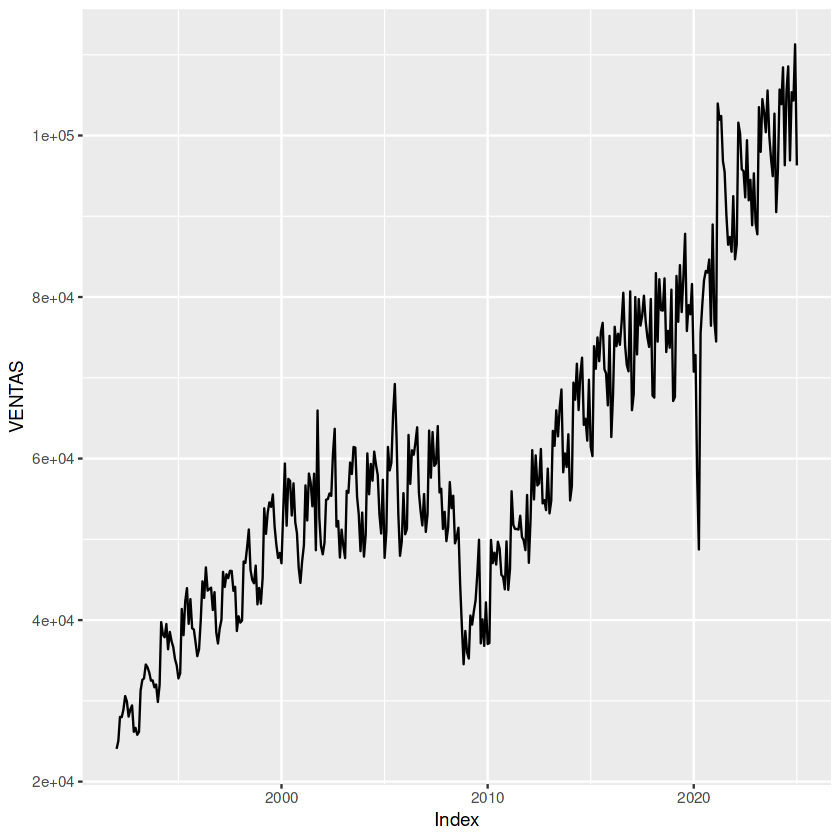

In [10]:
###Eliminamos los valores faltantes:
VENTAS%>%na.omit()%>%autoplot()
colnames(VENTAS)<-c("VENTAS")
head(VENTAS)
str(VENTAS)

In [11]:
##Comenzamos dando formato a la fecha y luego generamos el cambio del formato respectivo. Finalmente, renombramos las columnas.
xpr <- as.xts(VENTAS, dateFormat = "Date")
ventas <- fortify.zoo(xpr)  #Lo pasa a data frame restableiendo el formato de fecha
colnames(ventas)<-c("Date", "Ventas")
head(ventas)
tail(ventas)

,Date,Ventas
,<date>,<int>
1,1992-01-01,24056
2,1992-02-01,25041
3,1992-03-01,28018
4,1992-04-01,27982
5,1992-05-01,28924
6,1992-06-01,30591


,Date,Ventas
,<date>,<int>
392,2024-08-01,108560
393,2024-09-01,96915
394,2024-10-01,105358
395,2024-11-01,104327
396,2024-12-01,111285
397,2025-01-01,96294


In [12]:
str(ventas)

'data.frame':	397 obs. of  2 variables:
 $ Date  : Date, format: "1992-01-01" "1992-02-01" ...
 $ Ventas: int  24056 25041 28018 27982 28924 30591 29934 28052 28949 29429 ...


In [13]:
ventas%>%plot_time_series(Date, VENTAS, .interactive = TRUE)

Don't know how to automatically pick scale for object of type <xts/zoo>.
Defaulting to continuous.


HTML widgets cannot be represented in plain text (need html)

In [14]:
#Pasamos la serie a formato ts indicando una frecuencia mensual:
ventas.ts=ts(ventas$Ventas, start= c(1992,01),frequency = 12)
str(ventas.ts)

 Time-Series [1:397] from 1992 to 2025: 24056 25041 28018 27982 28924 30591 29934 28052 28949 29429 ...


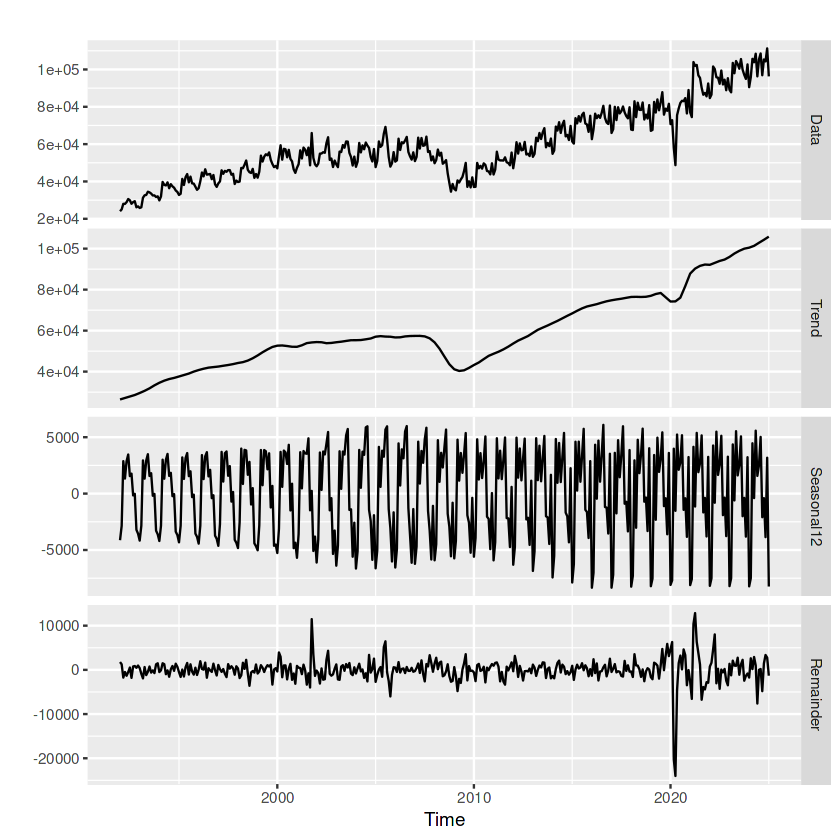

In [15]:
# la función mstl, para la descomposición de series de tiempo.
mstl(ventas.ts)%>% autoplot()

In [16]:
#Features:
tsfeatures(ventas.ts)

frequency,nperiods,seasonal_period,trend,spike,linearity,curvature,e_acf1,e_acf10,seasonal_strength,peak,trough,entropy,x_acf1,x_acf10,diff1_acf1,diff1_acf10,diff2_acf1,diff2_acf10,seas_acf1
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
12,1,12,0.9802469,6.205437e-08,17.48173,4.236183,0.3058808,0.2827543,0.6834259,8,1,0.217486,0.9485966,7.568649,-0.3600304,0.4533992,-0.6148705,0.9775623,0.8271996


In [17]:
detre= mstl(ventas.ts)
df_detrend <- ventas.ts - detre[,2]
ts_seasonal(df_detrend, type = "box")

HTML widgets cannot be represented in plain text (need html)

In [26]:
#Podemos igualmente segmentar la serie con funciones tipo window. Útil para probar modelos (entrenamiento, validación)
nValid <- 36
nTrain <- length(ventas.ts) - nValid
entren.ts <- window(ventas.ts, start = c(1992, 1), end = c(1992, nTrain))
length(entren.ts)
valid.ts <- window(ventas.ts, start = c(1992, nTrain + 1), end = c(1992, nTrain + nValid))
length(valid.ts)

[1] 361

[1] 36

In [27]:
valid.ts

,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
2022,,86517,101594,100257,95815,95591,92339,99414,91974,94514,88888,95315
2023,89133,87771,103509,97979,104507,102861,100406,105573,99898,97143,94960,102704
2024,90514,95883,105692,103876,108436,96318,105392,108560,96915,105358,104327,111285
2025,96294,,,,,,,,,,,


Apliquemos algunos modelos de pronósticos. Comencemos con modelo de regresión múltiple lineal con función tslm.

In [28]:
## Con tslm()
entren.lm.compo <-tslm(entren.ts~I(trend)+I(trend^2)+I(trend^3)+season)  #notar que season es con minúscula, no es el nombre de la columna del mes.
summary(entren.lm.compo)
#str(entren.lm.compo)


Call:
tslm(formula = entren.ts ~ I(trend) + I(trend^2) + I(trend^3) + 
    season)

Residuals:
   Min     1Q Median     3Q    Max 
-35004  -2571    944   3502  15634 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  1.816e+04  1.636e+03  11.098  < 2e-16 ***
I(trend)     4.691e+02  3.059e+01  15.333  < 2e-16 ***
I(trend^2)  -2.646e+00  1.962e-01 -13.485  < 2e-16 ***
I(trend^3)   5.229e-03  3.564e-04  14.673  < 2e-16 ***
season2      1.534e+03  1.541e+03   0.996 0.319954    
season3      1.008e+04  1.541e+03   6.543 2.17e-10 ***
season4      6.487e+03  1.541e+03   4.211 3.25e-05 ***
season5      1.022e+04  1.540e+03   6.636 1.25e-10 ***
season6      8.870e+03  1.540e+03   5.758 1.88e-08 ***
season7      9.531e+03  1.540e+03   6.187 1.73e-09 ***
season8      1.067e+04  1.540e+03   6.924 2.14e-11 ***
season9      4.956e+03  1.540e+03   3.217 0.001417 ** 
season10     5.061e+03  1.541e+03   3.285 0.001122 ** 
season11     1.741e+03  1.541e+03   1.130 0.259

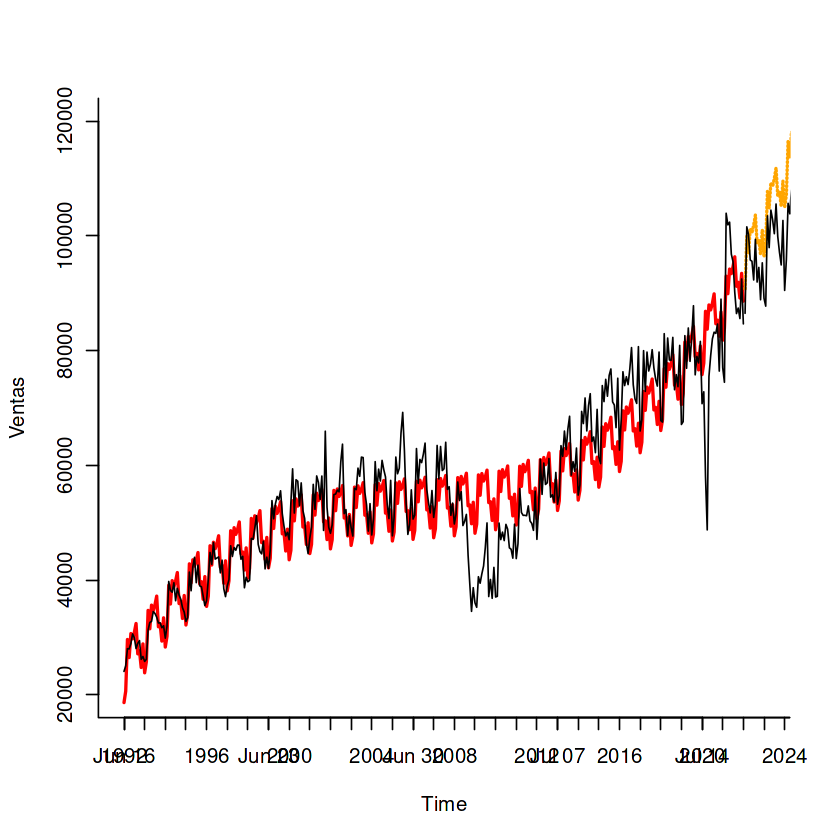

In [29]:
#Generamos su visualización:
entren.lm.compo.pre = forecast(entren.lm.compo, h=nValid)
plot(ventas, ylim=c(20000,120000), ylab="Ventas", xlab="Time", bty="l", xlim=c(1992,2023), main="", flty=2)
axis(1, at=seq(1992,2026,1), labels=format(seq(1992,2026,1)))
#lines(entren.lm.pred$fitted, lwd=2,col="red")
#lines(entren.lm.poli.pred$fitted, lwd=2,col="red")
#lines(entren.lm.poli.pred$mean, lwd = 2,lty = 3, col="orange")
lines(entren.lm.compo.pre$fitted, lwd=2,col="red")
lines(entren.lm.compo.pre$mean, lwd = 2,lty = 3, col="orange")
lines(valid.ts)
lines(entren.ts)

In [30]:
# Aplicamos función tslm() a todos los datos:
lm_all <-tslm(ventas.ts~I(trend)+I(trend^2)+I(trend^3)+season, lambda="auto")  #notar que season es con minúscula, no es el nombre de la columna del mes. #Aplicamos opcionalmente la función de Box Cox.
summary(lm_all)


Call:
tslm(formula = ventas.ts ~ I(trend) + I(trend^2) + I(trend^3) + 
    season, lambda = "auto")

Residuals:
     Min       1Q   Median       3Q      Max 
-0.97956 -0.06997  0.04201  0.13892  0.56525 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  1.417e+01  5.857e-02 241.886  < 2e-16 ***
I(trend)     1.754e-02  9.949e-04  17.633  < 2e-16 ***
I(trend^2)  -8.386e-05  5.805e-06 -14.448  < 2e-16 ***
I(trend^3)   1.464e-07  9.588e-09  15.273  < 2e-16 ***
season2      6.481e-02  5.517e-02   1.175 0.240818    
season3      3.724e-01  5.517e-02   6.751 5.47e-11 ***
season4      2.560e-01  5.516e-02   4.641 4.78e-06 ***
season5      3.727e-01  5.516e-02   6.757 5.29e-11 ***
season6      3.306e-01  5.516e-02   5.993 4.75e-09 ***
season7      3.438e-01  5.516e-02   6.232 1.22e-09 ***
season8      3.855e-01  5.516e-02   6.989 1.24e-11 ***
season9      1.912e-01  5.516e-02   3.466 0.000588 ***
season10     1.969e-01  5.516e-02   3.569 0.000404 ***
season11  

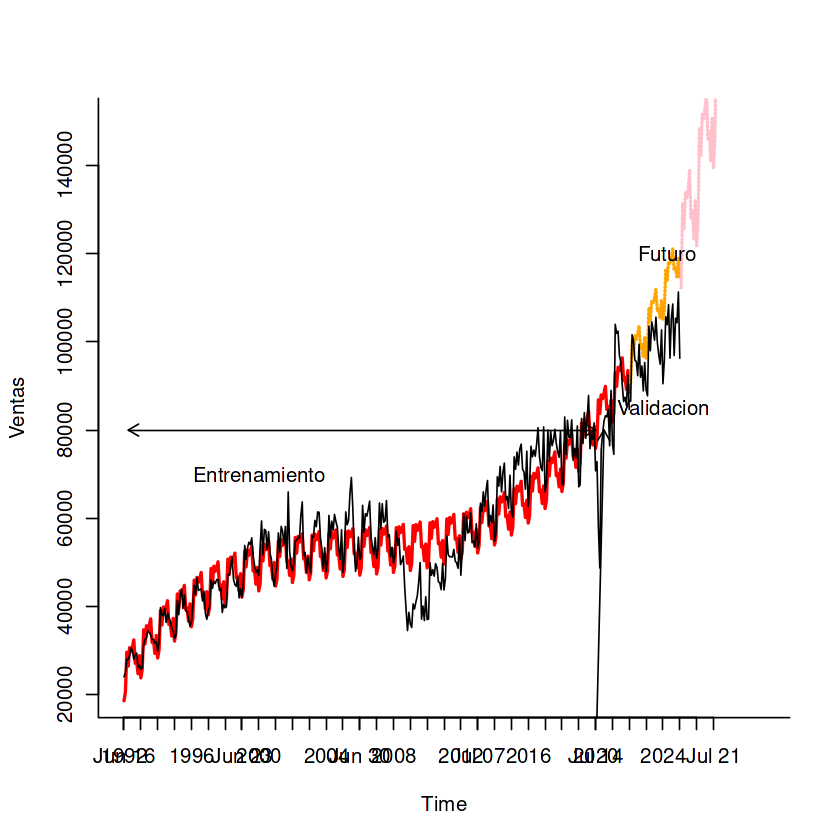

In [31]:
# Generamos su visualización con pronóstico (función:forecast): 
pron_fwd = forecast(lm_all, h=30)
plot(ventas, ylim=c(20000,150000), ylab="Ventas", xlab="Time", bty="l", xlim=c(1992,2030), main="", flty=2)
axis(1, at=seq(1992,2026,1), labels=format(seq(1992,2026,1)))
#lines(entren.lm.pred$fitted, lwd=2,col="red")
#lines(entren.lm.poli.pred$fitted, lwd=2,col="red")
#lines(entren.lm.poli.pred$mean, lwd = 2,lty = 3, col="orange")
lines(entren.lm.compo.pre$fitted, lwd=2,col="red")
lines(entren.lm.compo.pre$mean, lwd = 2,lty = 3, col="orange")
lines(pron_fwd$mean, lwd = 2,lty = 3, col="pink") ##Futuro: FWD Forecast
lines(valid.ts)
lines(entren.ts)
lines(c(2004.25 - 3, 2004.25 - 3), c(0, 3500)) 
lines(c(2004.25, 2004.25), c(0, 3500))
text(2000, 70000, "Entrenamiento")
text(2024, 85000, "Validacion")
text(2024.25, 120000, "Futuro")
arrows(2023 - 3, 80000, 1992.25, 80000, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2023.5 - 3, 80000, 2020, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
#arrows(2023.5, 100000, 2026, 100000, code = 3, length = 0.1, lwd = 1, angle = 30)

## Con Model Time

In [32]:
#la función de time_series_split genera en un solo paso, la partición de la serie, especificando el periodo respectivo para la prueba. El objeto debe ser ipo data frame
splits <- ventas %>%
  time_series_split(assess = "36 months", cumulative = TRUE)

Using date_var: Date



In [33]:
#Podemos visualiar la serie con el conjunto de entrenamiento y de prueba, además, adicionando una lpinea de suavizamiento a la tendecia. 
#Podemos también solicitar que la visualización sea interactiva o no. En este caso, optamos por interactiva.
splits %>%
  tk_time_series_cv_plan() %>%
  plot_time_series_cv_plan(Date, Ventas, .interactive = TRUE)

HTML widgets cannot be represented in plain text (need html)

In [36]:
# Especificamos que la fecha sea numérica y que los features se traten como factores. Importante indicar ordered como FALSE para que conserve el ordenamiento de fechas y no de valores.
model_fit_lm <- linear_reg() %>%
    set_engine("lm") %>%
    fit(Ventas ~ as.numeric(Date) + factor(month(Date),ordered = FALSE),
        data = training(splits))
#model_fit_lm  #Si deseamos observar el resultado del modelo

In [41]:
##Modleo MARS:
model_spec_mars <- mars(mode = "regression") %>%
    set_engine("earth") 

recipe_spec <- recipe(Ventas ~ Date, data = training(splits)) %>%
  step_timeseries_signature(Date) %>%
  step_rm(contains("am.pm"), contains("hour"), contains("minute"),
          contains("second"), 
contains("xts")) %>%step_dummy(all_nominal())
recipe_spec %>% prep() %>% juice() %>% head()

Date,Ventas,Date_index.num,Date_year,Date_year.iso,Date_half,Date_quarter,Date_month,Date_day,Date_wday,⋯,Date_month.lbl_08,Date_month.lbl_09,Date_month.lbl_10,Date_month.lbl_11,Date_wday.lbl_1,Date_wday.lbl_2,Date_wday.lbl_3,Date_wday.lbl_4,Date_wday.lbl_5,Date_wday.lbl_6
<date>,<int>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1992-01-01,24056,694224000,1992,1992,1,1,1,1,4,⋯,0.04307668,-0.01721256,0.005456097,-0.001190618,2.098124e-17,-4.364358e-01,4.532467e-17,0.4834938,5.342065e-16,-0.65795169
1992-02-01,25041,696902400,1992,1992,1,1,2,1,7,⋯,-0.23887978,0.12361750,-0.049104871,0.013096797,5.669467e-01,5.455447e-01,4.082483e-01,0.2417469,1.091089e-01,0.03289758
1992-03-01,28018,699408000,1992,1992,1,1,3,1,1,⋯,0.46601138,-0.35520473,0.190963389,-0.065483987,-5.669467e-01,5.455447e-01,-4.082483e-01,0.2417469,-1.091089e-01,0.03289758
1992-04-01,27982,702086400,1992,1992,1,2,4,1,4,⋯,-0.25454403,0.47412790,-0.409207262,0.196451960,2.098124e-17,-4.364358e-01,4.532467e-17,0.4834938,5.342065e-16,-0.65795169
1992-05-01,28924,704678400,1992,1992,1,2,5,1,6,⋯,-0.28978859,-0.15960741,0.491048715,-0.392903920,3.779645e-01,0.000000e+00,-4.082483e-01,-0.5640761,-4.364358e-01,-0.19738551
1992-06-01,30591,707356800,1992,1992,1,2,6,1,2,⋯,0.27412434,-0.32860349,-0.229156067,0.550065488,-3.779645e-01,9.690821e-17,4.082483e-01,-0.5640761,4.364358e-01,-0.19738551


In [42]:
# Modelo MARS o earth ----
model_spec_mars <- mars(mode = "regression") %>%
    set_engine("earth") 
##Anexamos al workflow:  
wflw_fit_mars <- workflow() %>%
   add_recipe(recipe_spec) %>%
    add_model(model_spec_mars) %>%
    fit(training(splits))


Attaching package: ‘plotrix’


The following object is masked from ‘package:scales’:

    rescale




In [43]:
#Anexamos modelo al modeltime:
models_tbl <- modeltime_table(
    model_fit_lm,
    wflw_fit_mars)

In [44]:
### Calibración:
calibration_tbl <- models_tbl %>%
    modeltime_calibrate(new_data = testing(splits))

In [45]:
## Forecast validación, métricos de error
calibration_tbl %>%
    modeltime_forecast(
        new_data    = testing(splits),
        actual_data = ventas
    ) %>%
    plot_modeltime_forecast(
      .legend_max_width = 25,
      .interactive      = interactive
    )

HTML widgets cannot be represented in plain text (need html)

In [46]:
#Determinación métricos error:
calibration_tbl %>%
    modeltime_accuracy() %>%
    table_modeltime_accuracy(
        .interactive = interactive
    )

HTML widgets cannot be represented in plain text (need html)

In [47]:
## Refitting con toda la base de datos:
refit_tbl <- calibration_tbl %>%
    modeltime_refit(data = ventas)

In [48]:
## Pronostico hacia adelante:
refit_tbl <- calibration_tbl %>%
    modeltime_refit(data = ventas)
refit_tbl %>%
    modeltime_forecast(h = "12 months", actual_data = ventas) %>%
    plot_modeltime_forecast(
      .legend_max_width = 25, 
      .interactive      = interactive
    )

HTML widgets cannot be represented in plain text (need html)

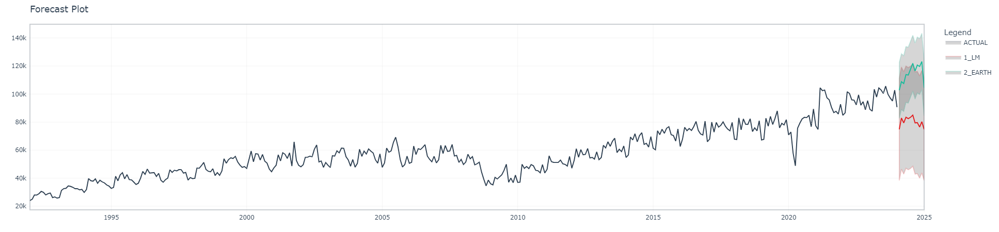

In [94]:
## Pronostico hacia adelante, variando el formato para la ventana en años:
calibration_tbl %>%
    modeltime_forecast(h = "1 years", actual_data = ventas) %>%
    plot_modeltime_forecast(
      .legend_max_width = 25, # For mobile screens
      .interactive      = interactive)

## Revision de Adecuación al Modelo (Residuales)


Attaching package: ‘performance’


The following objects are masked from ‘package:yardstick’:

    mae, rmse





	Shapiro-Wilk normality test

data:  lm_all$resid
W = 0.89027, p-value = 2.966e-16


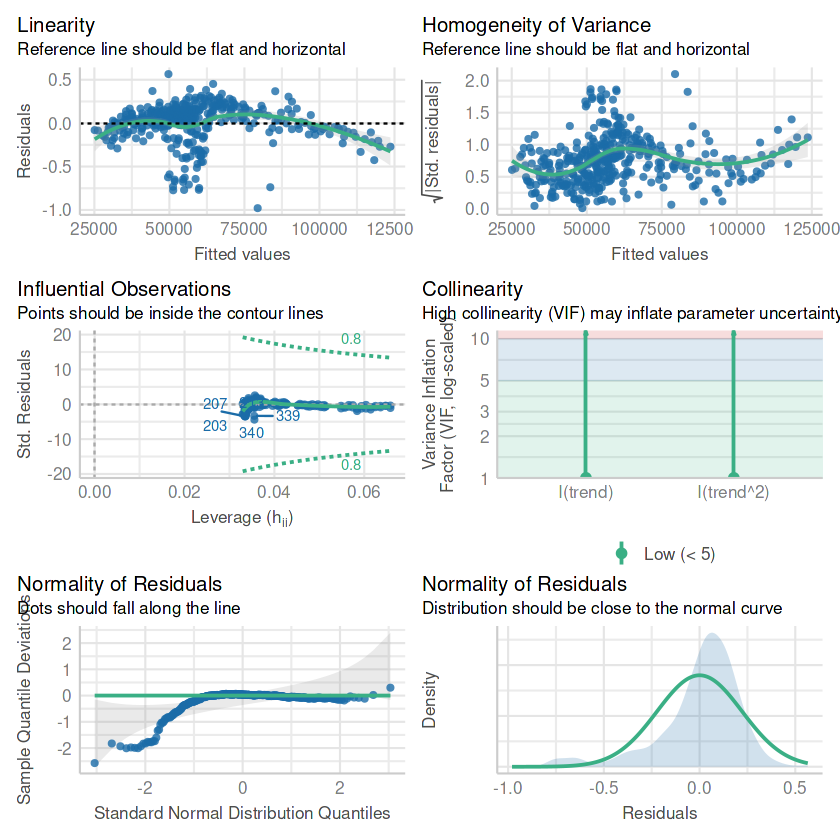

In [49]:
library(performance)
check_model(lm_all)
shapiro.test(lm_all$resid)

Notamos que este modelo lineal no cumple con adecuación al modelo, la prueba de normalidad y la homogeneidad de varianzas. Revisamos ahora, ambos modelos con paquetería ModelTime.

In [50]:
modeltime_residuals(calibration_tbl, new_data = NULL)%>%
    plot_modeltime_residuals(.interactive = TRUE)

HTML widgets cannot be represented in plain text (need html)

Los residuos se notan estables.

In [51]:
rlm  = modeltime_residuals(calibration_tbl, new_data = NULL)[1:36,c(1,7)]
rmars = modeltime_residuals(calibration_tbl, new_data = NULL)[37:72,c(1,7)]
head(rlm)

.model_id,.residuals
<int>,<dbl>
1,12828.88
1,19168.09
1,21231.29
1,12861.09
1,13795.06
1,9687.86


In [52]:
#Modelo Lineal
rlm2 = as.numeric(unlist(as.data.frame(rlm[,2])))
shapiro.test(rlm2)
#as.data.frame(rlm[,2])
#rlm
# Modelo MARS
rmars2 = as.numeric(unlist(as.data.frame(rmars[,2])))
shapiro.test(rmars2)


	Shapiro-Wilk normality test

data:  rlm2
W = 0.97858, p-value = 0.6975



	Shapiro-Wilk normality test

data:  rmars2
W = 0.98207, p-value = 0.8129


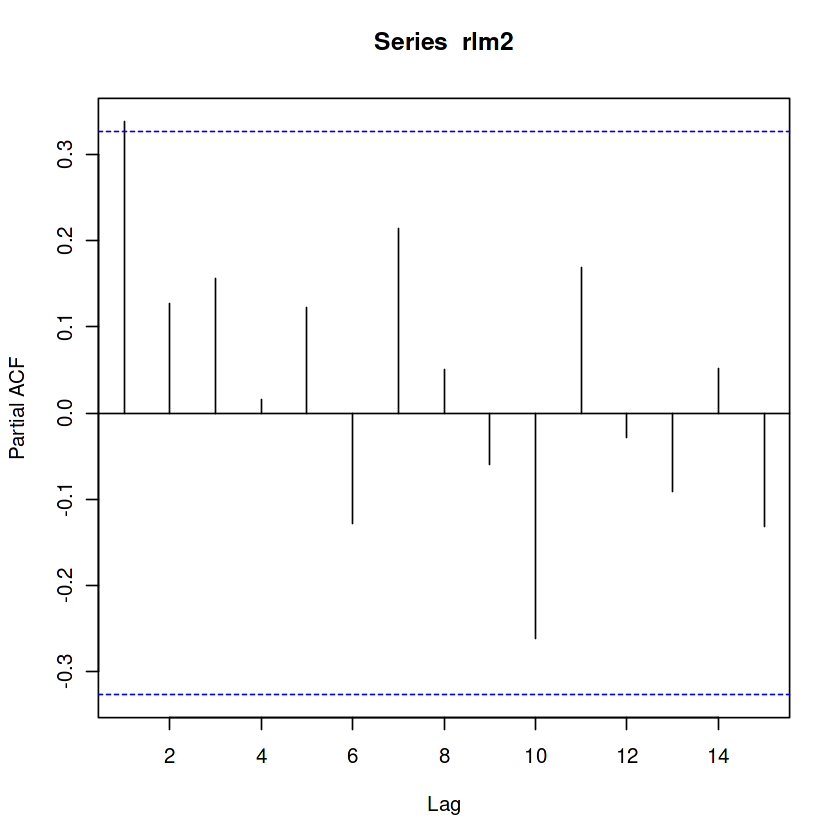

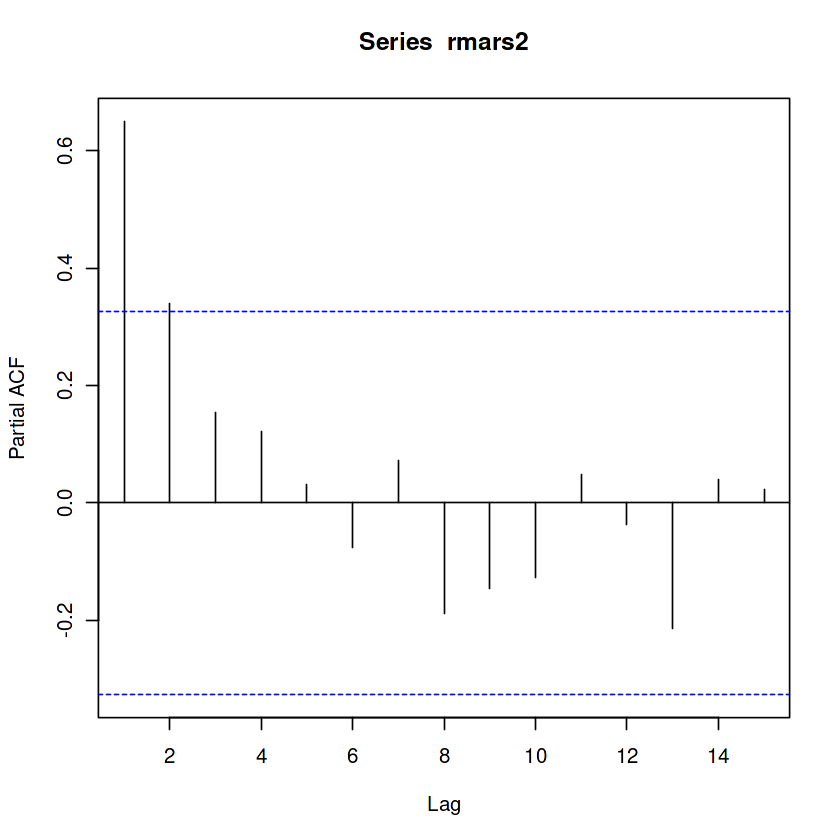

In [53]:
pacf(rlm2)
pacf(rmars2)

Observamos que no hay dependencia de residuos en ninguno de los modelos. Con estos modelos, ambas regresiones cumplen con los supuestos de adecuación al modelo.

In [99]:
#Concluios que los modelos lineales cumplen especificación de normalidad bajo el modelo TimeModel, la función con tslm no. En el modelo tslm no cumple, aún con transformaciones Box-Cox.